In [22]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
train = pd.read_csv('./seti-breakthrough-listen/train_labels.csv')
print('Train shape is', train.shape )
train.head()

train['img_path']=train['id'].apply(lambda x:f'./seti-breakthrough-listen/train/{x[0]}/{x}.npy')
train.head()
def deviation_cadence_horizontal (dataset, reading):
    reading = np.take(reading, [0,2,4], 0)
    return_object = edited_cadence = np.empty((3, 256, 256))
    for i in range(3):
        cadence = reading[i][0:256]
        cadence = cadence.T
        for j in range(len(cadence)-1):
            for k in range(len(cadence[j])):
                cadence[j][k] = abs(cadence[j][k] - cadence[j+1][k])
        return_object[i] = cadence.T
    return return_object

def draw(cadences):
    figure = plt.figure(figsize=(30, 8))
    for i in range(len(cadences)):
        cadence = cadences[i][0:256]
        ax = plt.subplot(3, 1, i +1)
        plt.imshow(cadence.astype(float), interpolation='nearest', aspect='auto')
        print('mean: ' + str(np.mean(cadence, dtype=np.float64)))
        print('std: ' + str(np.std(cadence, dtype=np.float64)))
        plt.colorbar()
    plt.show()

def cut_off_extremes(dataset):
    data_mean, data_std = np.mean(dataset, dtype=np.float64), np.std(dataset, dtype=np.float64)
    cut_off = data_std * 3
    lower, upper = data_mean - cut_off, data_mean + cut_off
    for ix,iy in np.ndindex(dataset.shape):
        if (dataset[ix,iy] < lower or dataset[ix,iy] > upper):
            dataset[ix,iy] = data_mean
    return dataset


Train shape is (60000, 2)


In [23]:
edited_cadence = []
for i in range(0,10):
    entry = train.loc[train['target'] == 1].iloc[i]
    reading = np.load(entry['img_path'])
    edited_cadence.append(deviation_cadence_horizontal(entry, reading))

target: 1 | id: 009720abc6c9db7
mean: -0.043311862953487434
std: 0.977328884767076
mean: 0.03835622782025894
std: 1.0140082382760531
mean: 0.0856654893132145
std: 0.9668538398555864


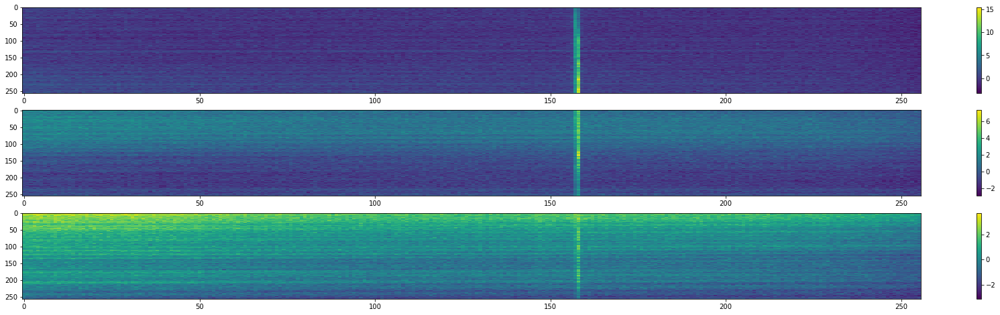

mean: -0.0992064804677284
std: 0.6985821963039122
mean: 0.023988739701962913
std: 0.9822604301279411
mean: 0.07799293596326606
std: 0.9543816056910654


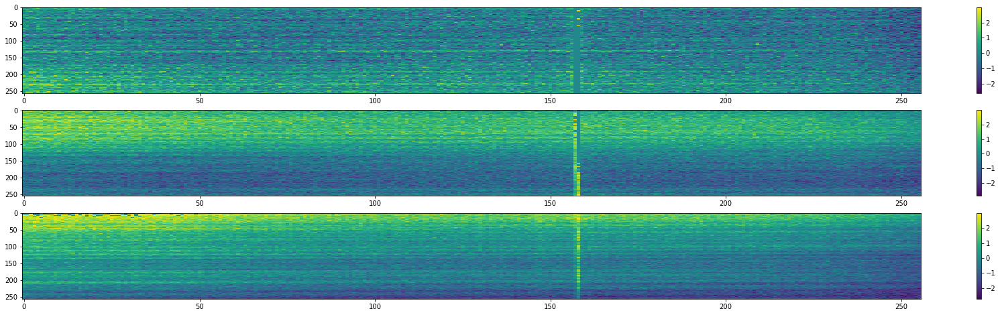

target: 1 | id: 00973367d6481e2
mean: -0.0328078696202283
std: 1.0058767603610248
mean: -0.08565496652954607
std: 0.952661328641026
mean: 0.04965357312812557
std: 0.9988885230171108


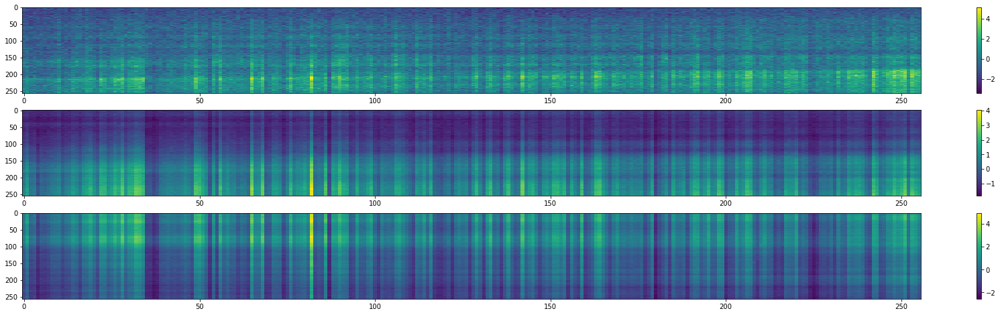

mean: -0.05163239316425461
std: 0.9712634305654827
mean: -0.08948344262626051
std: 0.9453139510347829
mean: 0.033979836907747085
std: 0.9707752897101387


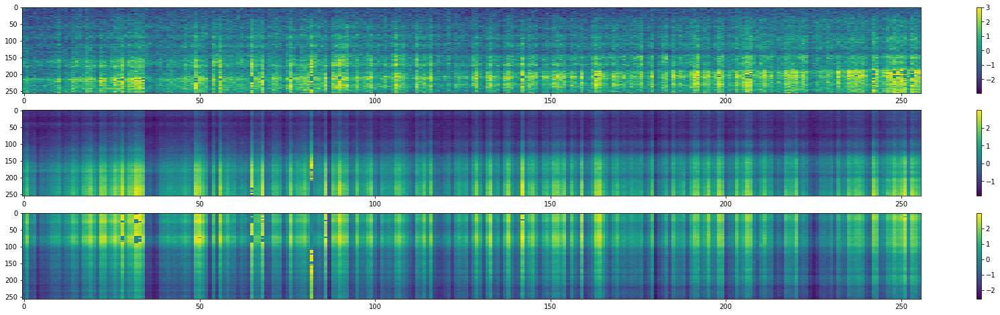

target: 1 | id: 0097ec9a99008e9
mean: 0.0396014209563873
std: 1.0068561132576221
mean: -0.02916238312900532
std: 0.9929511267228912
mean: -0.03193569937502616
std: 0.9930986527989087


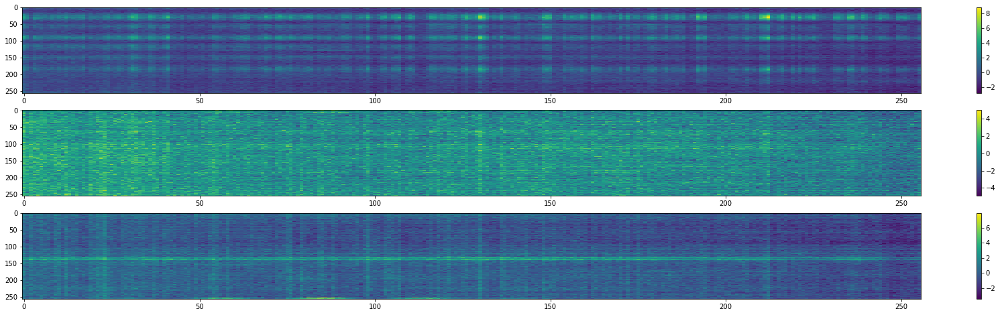

mean: -0.018370742368460924
std: 0.885128624951602
mean: -0.02743966982961865
std: 0.9779709937674356
mean: -0.08103767818465712
std: 0.8903464452254661


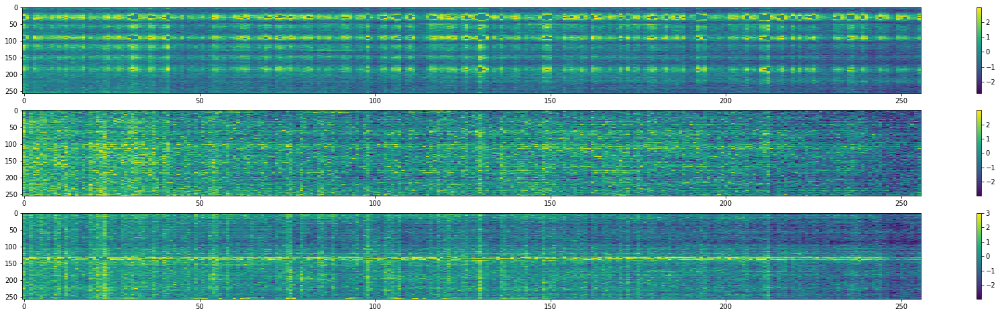

target: 1 | id: 00b2a4425260a05
mean: -0.00953552308419603
std: 0.988627478675081
mean: -0.014300886483397335
std: 0.9886876224519107
mean: 0.00010117696547240485
std: 1.0049230188422487


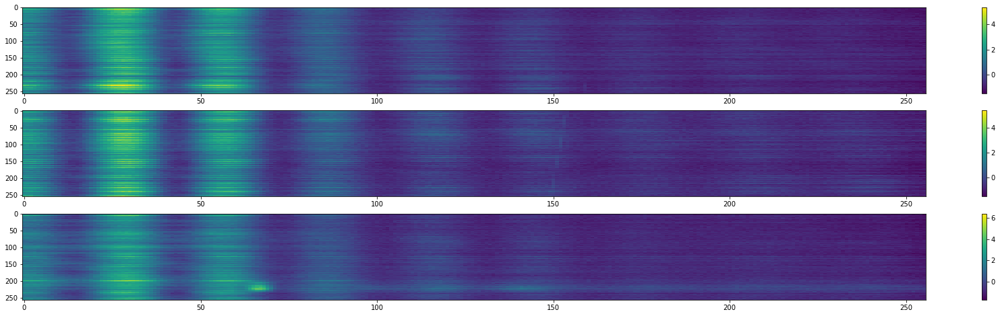

mean: -0.05373687017618067
std: 0.9063404972383663
mean: -0.07275095087788941
std: 0.8755317622671351
mean: -0.04000294377146929
std: 0.9320497649952957


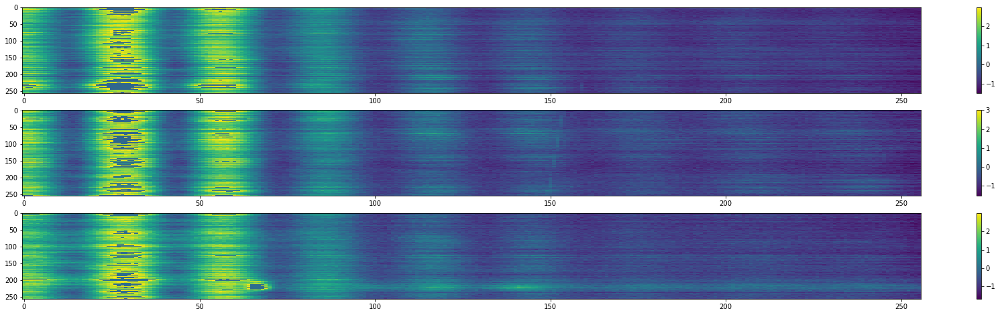

target: 1 | id: 00b4347b13585b3
mean: -0.0033525600119901355
std: 0.9953207559401637
mean: -0.06819755935430294
std: 0.9496490263276296
mean: -0.031536445677375013
std: 0.9641667110200768


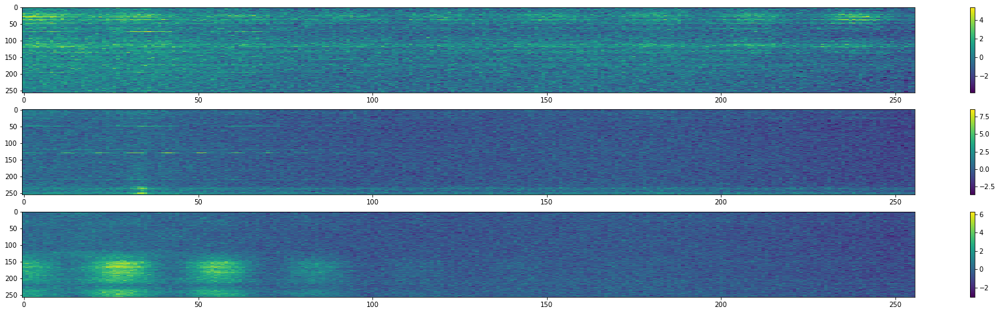

mean: -0.022075079335081682
std: 0.9569352275744588
mean: -0.08481074863811955
std: 0.9044728570257204
mean: -0.09165202578878962
std: 0.8342032075153512


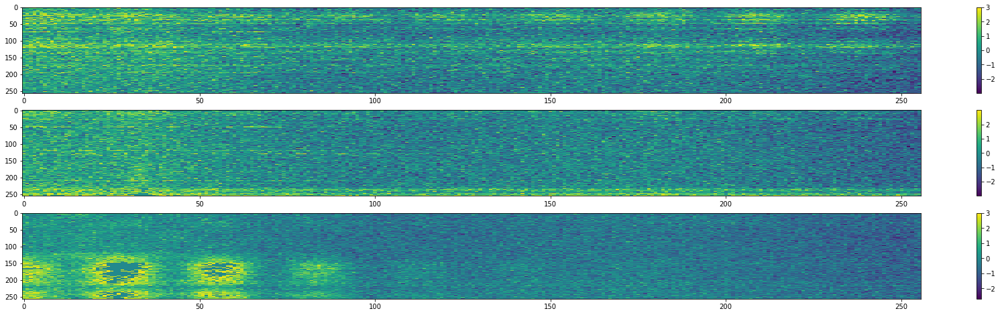

target: 1 | id: 00c04bff2a60225
mean: -0.002960340772915515
std: 0.99962950983737
mean: -0.02255716753188608
std: 1.0000940901582887
mean: 0.031196061416267185
std: 0.9957001592719159


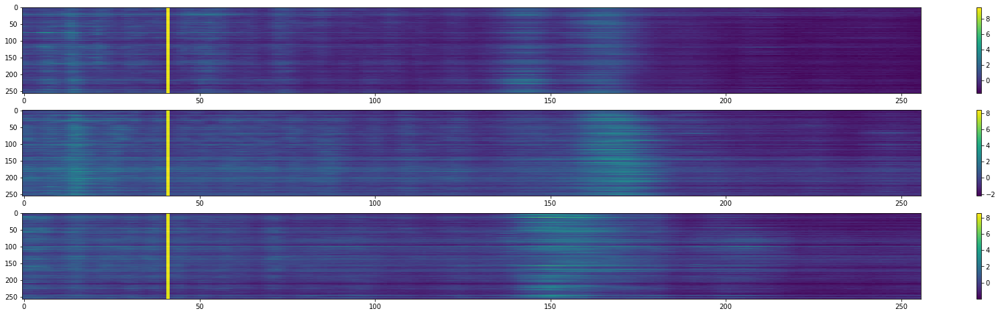

mean: -0.042395859283715254
std: 0.8120341903364402
mean: -0.060316751852042216
std: 0.8536594768280751
mean: -0.014116378351900494
std: 0.8277816572206237


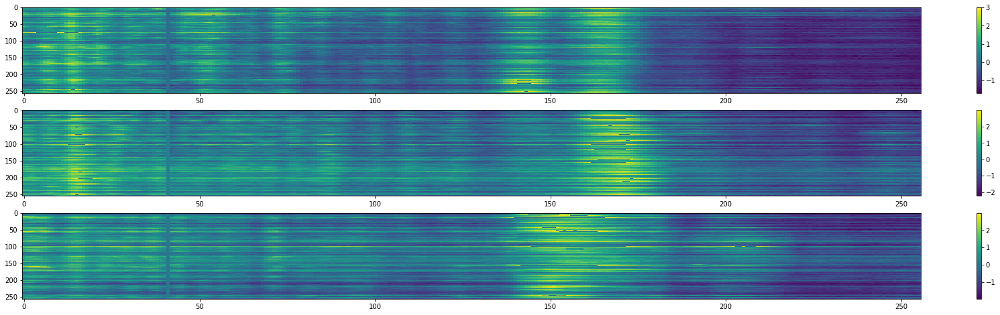

target: 1 | id: 00c8f01147c7cc4
mean: 0.004326321001826727
std: 1.0263495106687983
mean: -0.014177553799527232
std: 0.9437998314445484
mean: 0.004025583806651412
std: 1.0063100057999161


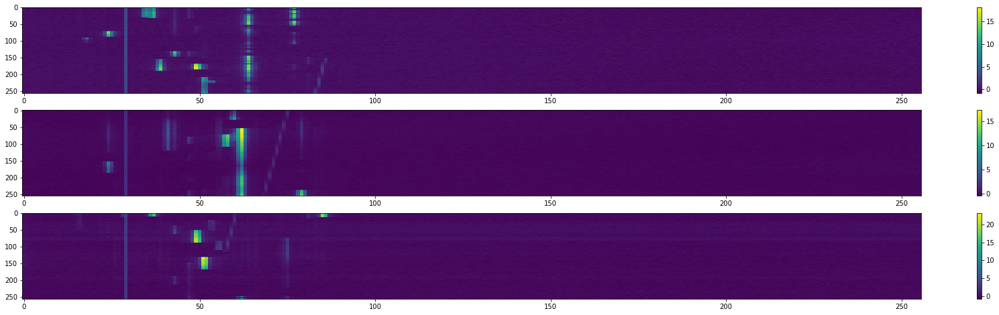

mean: -0.10810422998292779
std: 0.2693430140380116
mean: -0.10238040962576633
std: 0.2712742115423627
mean: -0.06081878084296477
std: 0.3111261347397771


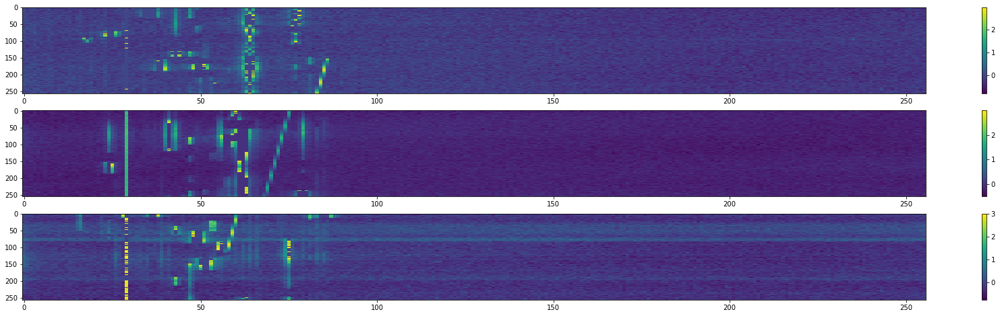

target: 1 | id: 00d80238102b3f9
mean: -9.222384051099652e-05
std: 1.0000175855920956
mean: 0.0007215716577775311
std: 0.9999877429597044
mean: 0.003200318666131352
std: 1.0000860030568512


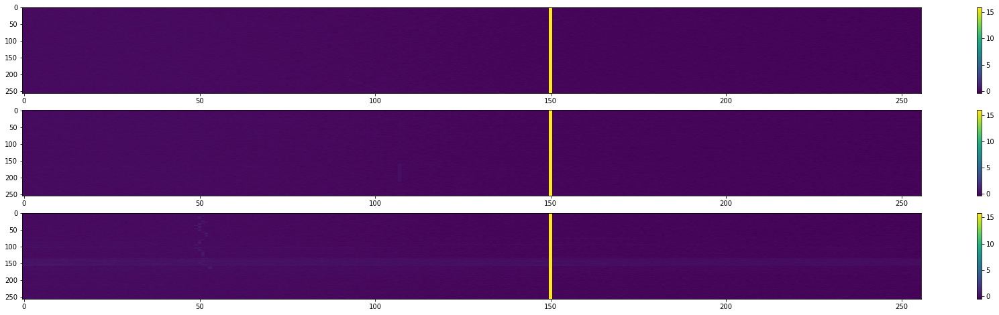

mean: -0.06210145712338999
std: 0.10872559624960926
mean: -0.061288156157388585
std: 0.10884527305286698
mean: -0.05847726343017712
std: 0.15134873812842414


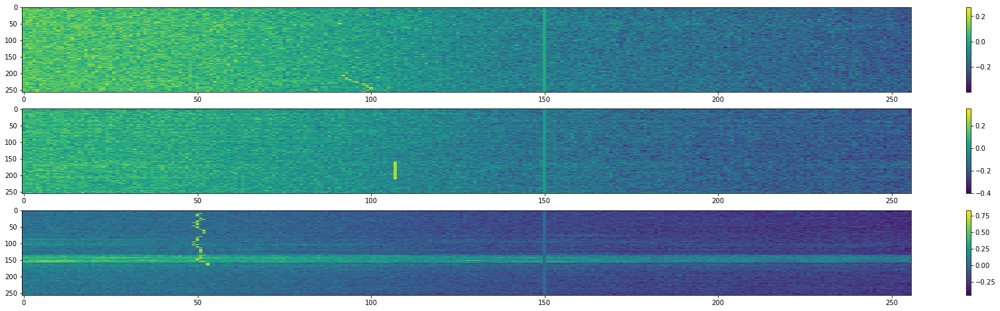

target: 1 | id: 00df498ae66a514
mean: 0.004144094769799267
std: 1.000468716678072
mean: 0.0014329520918181515
std: 1.022785151330304
mean: -0.063150828693324
std: 0.971637019890602


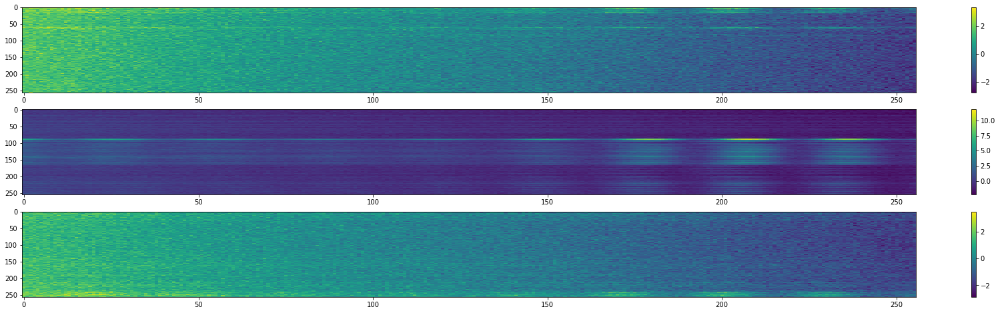

mean: 0.003812963209384179
std: 0.9999562980677127
mean: -0.06227777814365254
std: 0.8304819949046109
mean: -0.06353459167803521
std: 0.9709894708693265


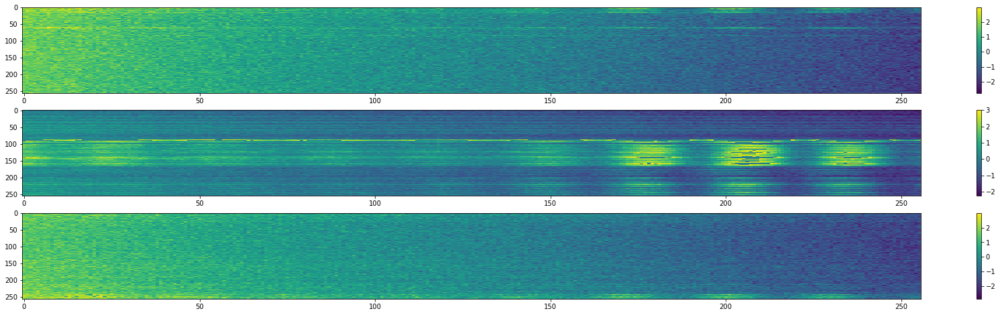

target: 1 | id: 00edbbb84f23f34
mean: -0.00856548361662135
std: 1.0058404477130833
mean: 0.02743294050287659
std: 0.9999089738726152
mean: 0.03852869304500928
std: 1.0025950401015686


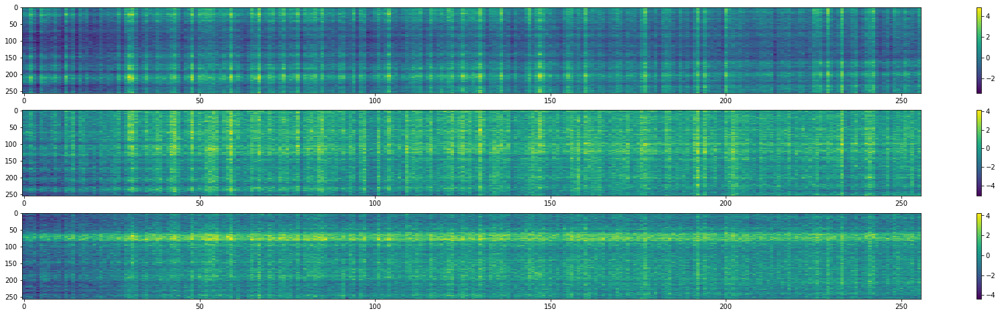

mean: -0.02342133960519277
std: 0.9781739064748091
mean: 0.03368952083019394
std: 0.9747074880670692
mean: 0.030346338875460788
std: 0.9710121007208746


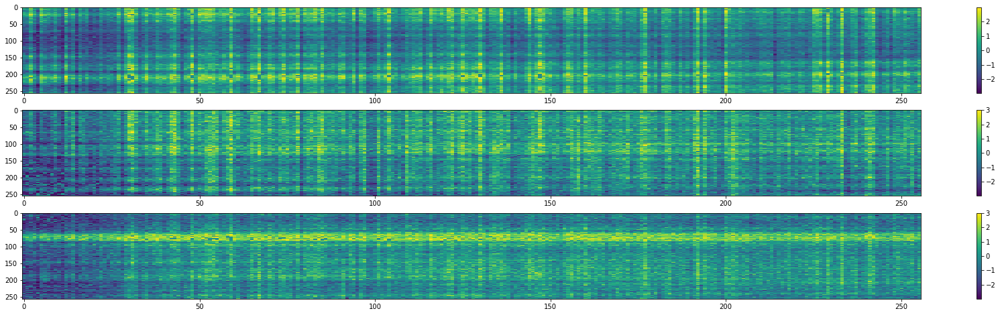

target: 1 | id: 00f0edf821fa96c
mean: 0.006853273367596557
std: 1.0197944792111566
mean: -0.017306763547821902
std: 0.9637740628554163
mean: 0.00828666442521353
std: 1.0097321238072328


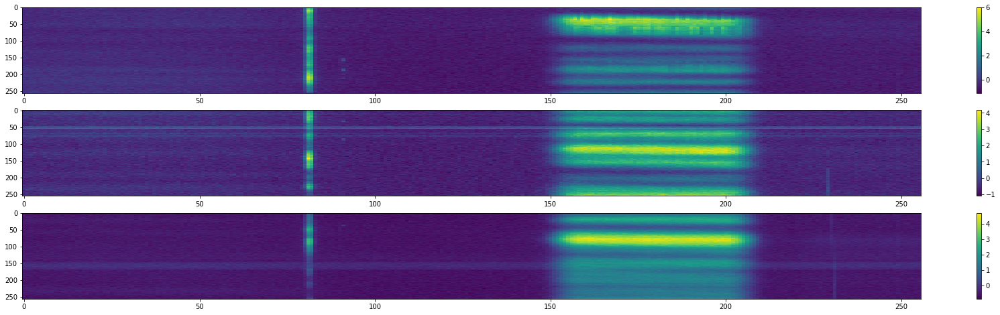

mean: -0.13118215711438097
std: 0.6777597756050059
mean: -0.07307256386047811
std: 0.8562081062762028
mean: -0.08400752299075975
std: 0.8095017833879433


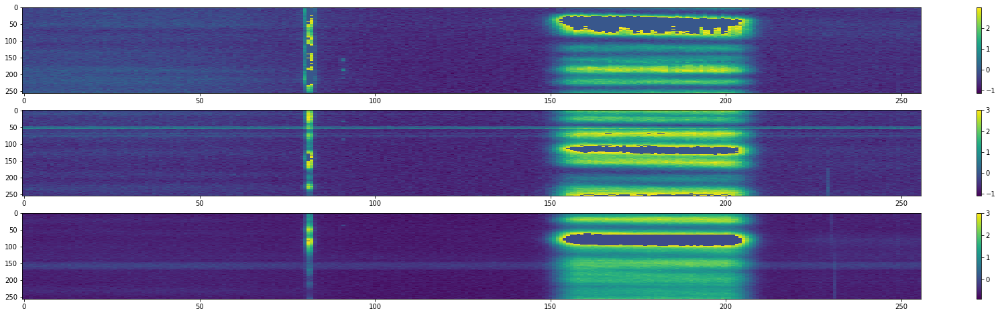

target: 1 | id: 00f129775fd7792
mean: 0.00018566894505056553
std: 1.0033101002782394
mean: 0.030018122607543773
std: 1.0255330468600083
mean: 0.00024231777751992922
std: 0.9985635168106057


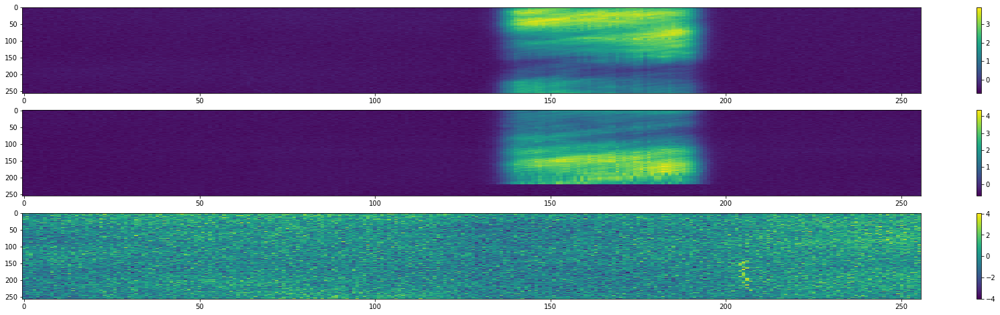

mean: -0.0751880298339529
std: 0.869308270930893
mean: -0.07794310971985396
std: 0.8269435771634823
mean: -0.0010207475816059741
std: 0.9823644906977902


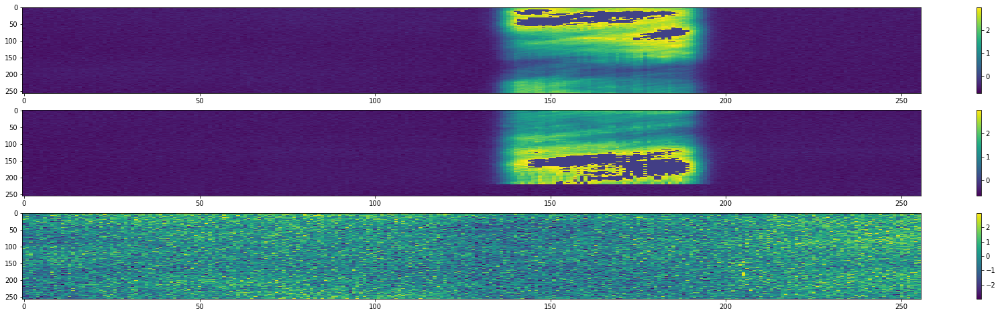

target: 1 | id: 00f26df3f203ca9
mean: -0.0006953944402994239
std: 1.0000879654613053
mean: 0.0011427251620261814
std: 0.9999446412977968
mean: 0.007333539769206254
std: 1.0000499481469838


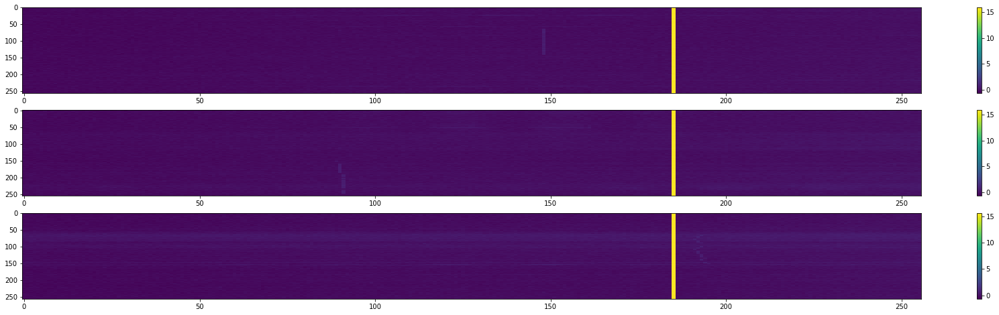

mean: -0.06243942733362928
std: 0.142557384074089
mean: -0.060403818916711316
std: 0.16284062490922913
mean: -0.05362615071408072
std: 0.2143786882276585


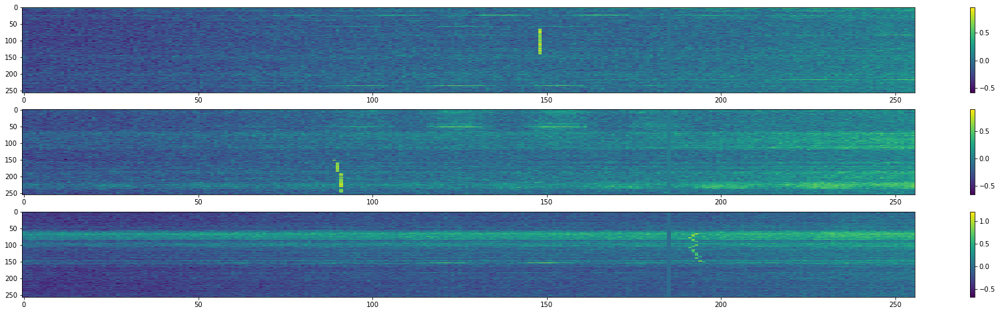

target: 1 | id: 00f5613da0cfcd6
mean: 0.03696853038127301
std: 1.0034937827945145
mean: -0.06474984250598936
std: 0.9773323483304381
mean: -0.008991357518425502
std: 1.014729205406403


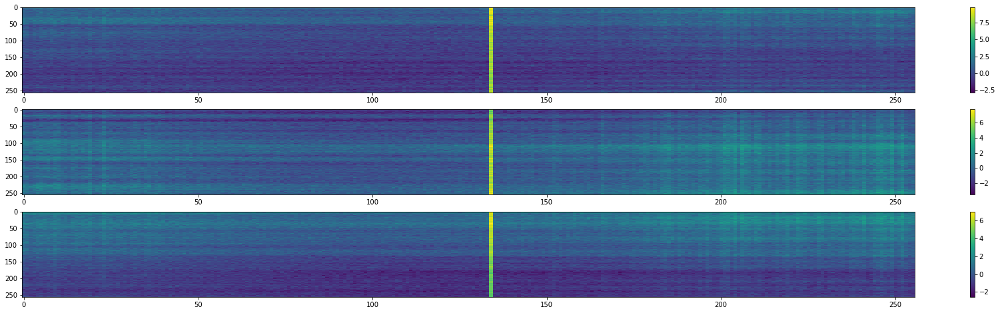

mean: 0.0019367142749615596
std: 0.8542243177030732
mean: -0.08922075332793611
std: 0.8906214945246204
mean: -0.03026677549678425
std: 0.9550666591481217


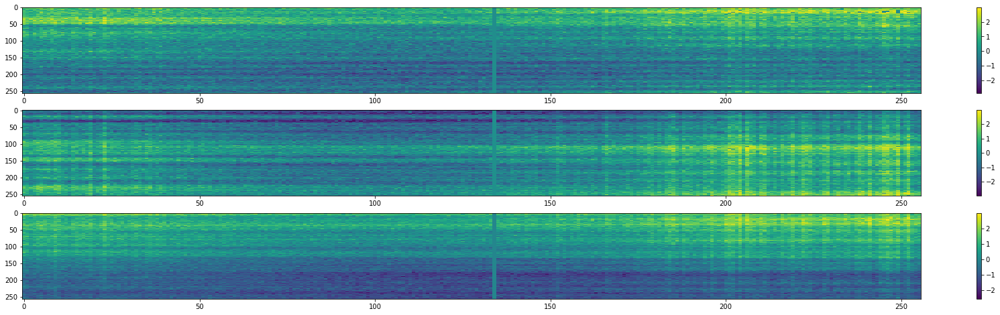

target: 1 | id: 00ffccd75595515
mean: 0.003194313115272962
std: 0.9990783396640819
mean: -0.007629394764990138
std: 1.0030446078153983
mean: 0.00037501731549127726
std: 1.0008624187782829


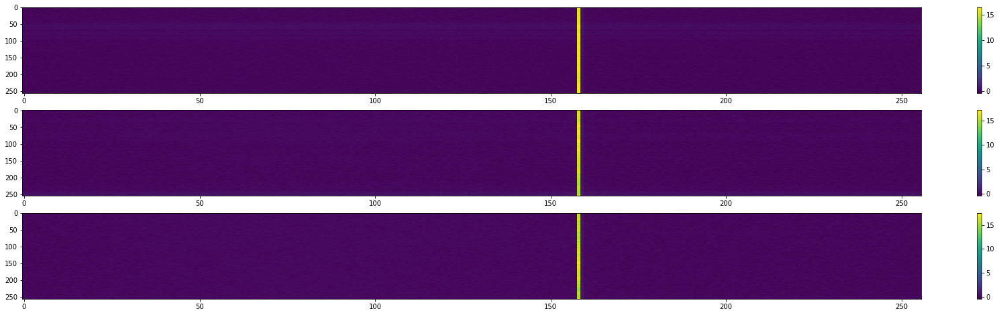

mean: -0.05873503993188933
std: 0.11272812026226885
mean: -0.06963416072630935
std: 0.1257250160467839
mean: -0.06173968009989039
std: 0.0954080408653692


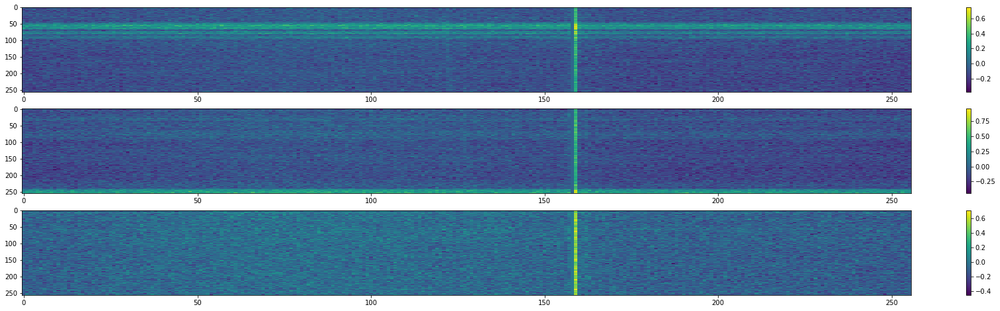

target: 1 | id: 01069888f1d29d1
mean: 0.025580107513633266
std: 1.010885421308141
mean: 0.008160675887666002
std: 1.0182153464164072
mean: -0.029982762746840308
std: 0.9699261181717965


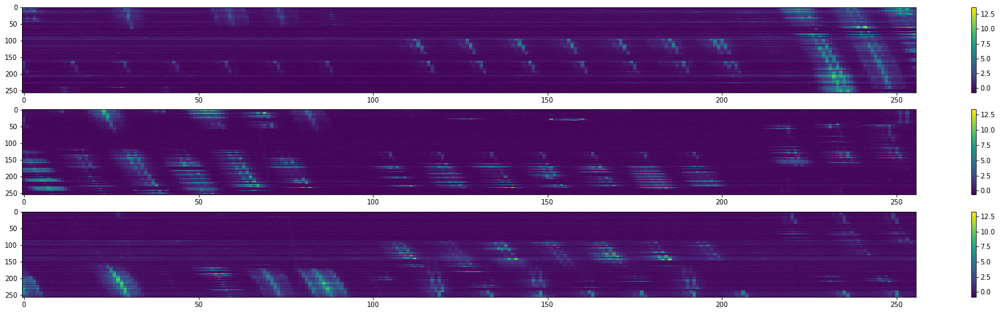

mean: -0.10263877221132134
std: 0.575805580093634
mean: -0.13012248711402208
std: 0.5546038787219424
mean: -0.1444529108075585
std: 0.5533635092555103


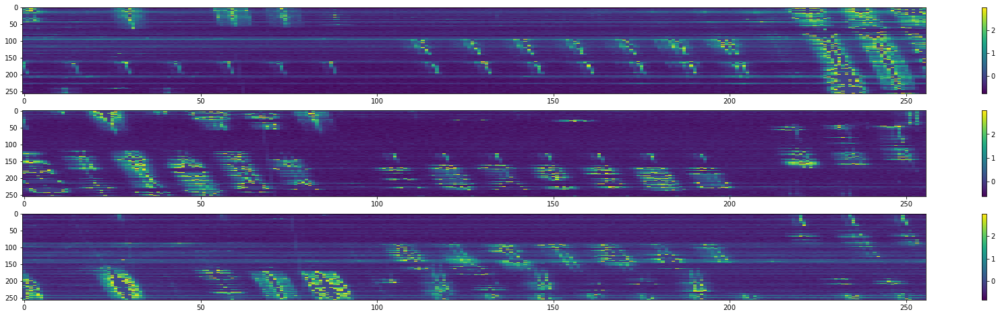

target: 1 | id: 010b8dc237f2d74
mean: -0.03473952498370636
std: 0.9478457546633499
mean: 0.025224838715075748
std: 1.02245117329579
mean: 0.06388263139433548
std: 0.9993311558237964


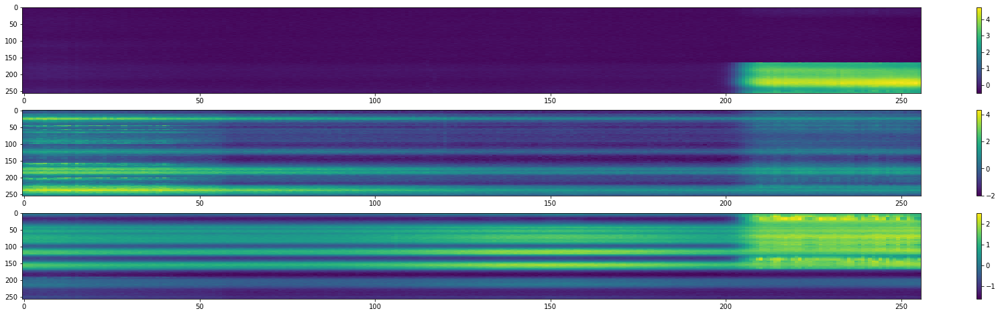

mean: -0.2025124863239398
std: 0.48470381294654435
mean: -0.005024121135647874
std: 0.9699673244404227
mean: 0.06388263139433548
std: 0.9993311558237964


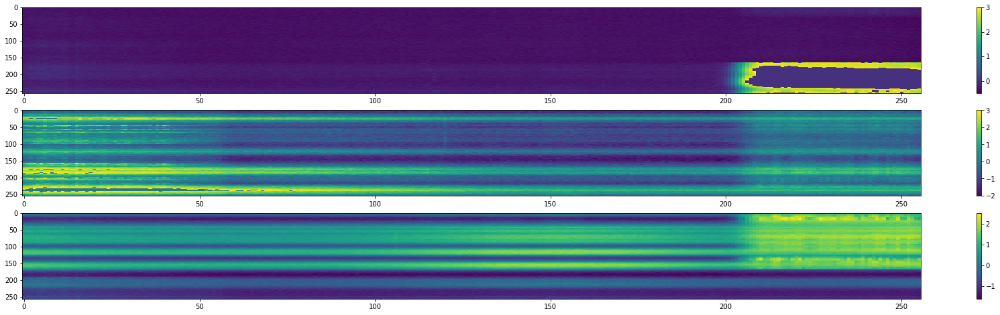

target: 1 | id: 011a24036ff34fa
mean: 0.06089837295439793
std: 0.9990432110327414
mean: -0.0011585722713789437
std: 1.0090735350655657
mean: -0.015063368158735102
std: 1.024440439724133


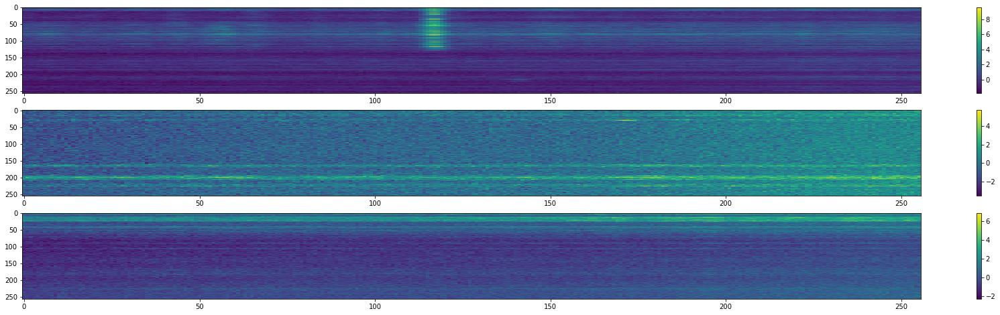

mean: -0.003026356869668234
std: 0.8406238886213693
mean: -0.027381897592022142
std: 0.9593350206128969
mean: -0.10081247225571133
std: 0.8396340379923115


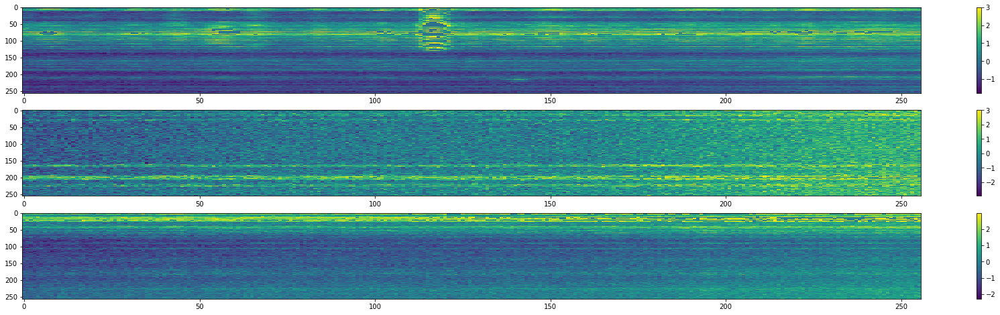

target: 1 | id: 011b28e735d732d
mean: -0.001963443835848011
std: 1.000074673007771
mean: -0.011239916057093069
std: 1.015578719669648
mean: 0.025090874960369547
std: 1.0147485880244476


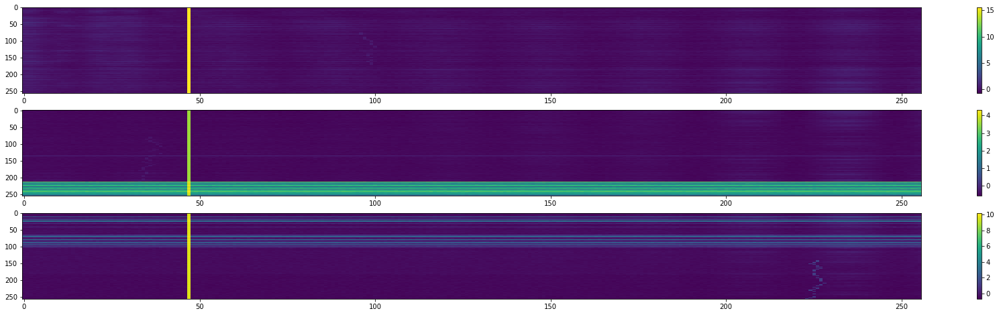

mean: -0.062386822668486275
std: 0.24820578939263266
mean: -0.07358177449805225
std: 0.908398716621038
mean: -0.06906848162361712
std: 0.6661176295405487


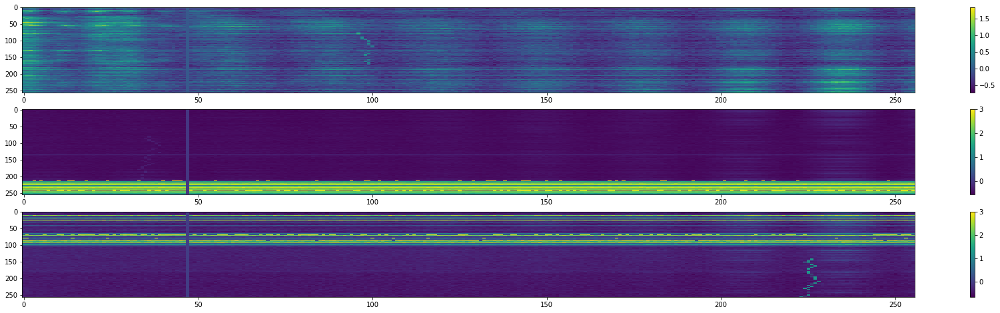

target: 1 | id: 0128021d0d9d7cb
mean: -0.002809052436532511
std: 1.000210935316888
mean: 0.00040880724918679334
std: 1.0000289936211386
mean: 0.001972571342776064
std: 1.0000025714541572


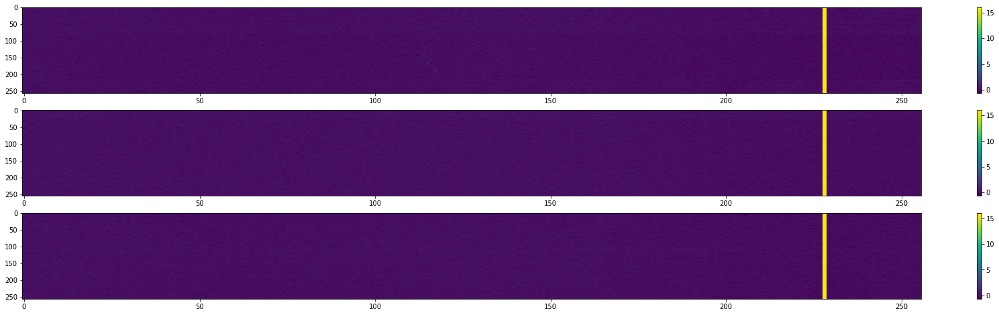

mean: -0.06457757049884094
std: 0.1396788957075855
mean: -0.06139399070161744
std: 0.135842966061309
mean: -0.0598436076179496
std: 0.13478952800379276


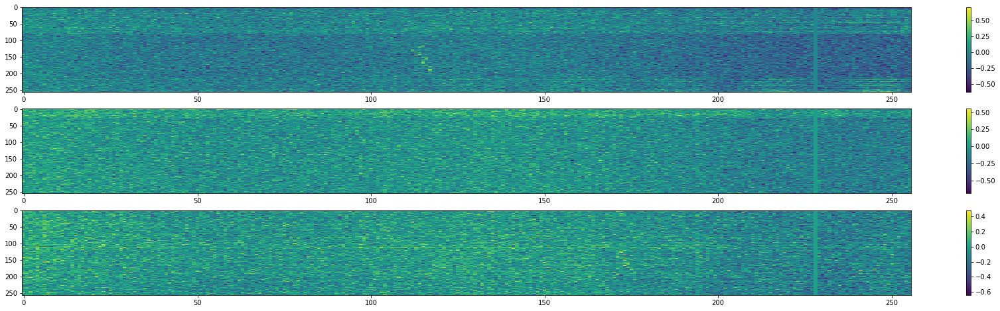

In [24]:

for i in range(10, 30):
    entry = train.loc[train['target'] == 1].iloc[i]
    reading = np.load(entry['img_path'])
    reading = np.take(reading, [0,2,4], 0)
    print('target: ' + str(entry.target) + ' | id: ' + str(entry.id))
    # fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)
    # axs[0].hist(reading[0], bins=200)
    draw(reading )
    for z in range(len(reading)):
        reading[z] = cut_off_extremes(reading[z])
    # for z in range(len(edited_cadence[i])):
    #     edited_cadence[i][z] = cut_off_extremes(edited_cadence[i][z])
    # axs[1].hist(reading[0], bins=200)

    draw(reading)
    #draw(edited_cadence[i])

target: 0 | id: 0000799a2b2c42d
mean: -0.03569870337287284
std: 0.9925918702019286
mean: 0.03648588840223965
std: 0.9969891383965309
mean: 0.007477820515305211
std: 1.0093906304990996


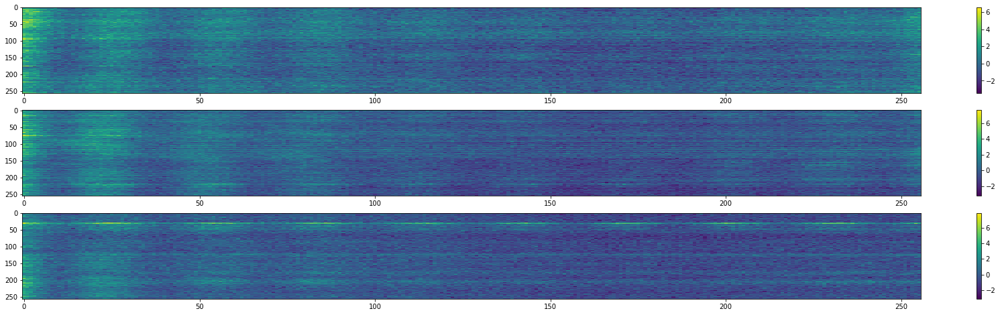

mean: -0.06288538657736353
std: 0.9342012727477516
mean: 0.005046947473601904
std: 0.9348269554081321
mean: -0.045760689071357774
std: 0.8921430000302094


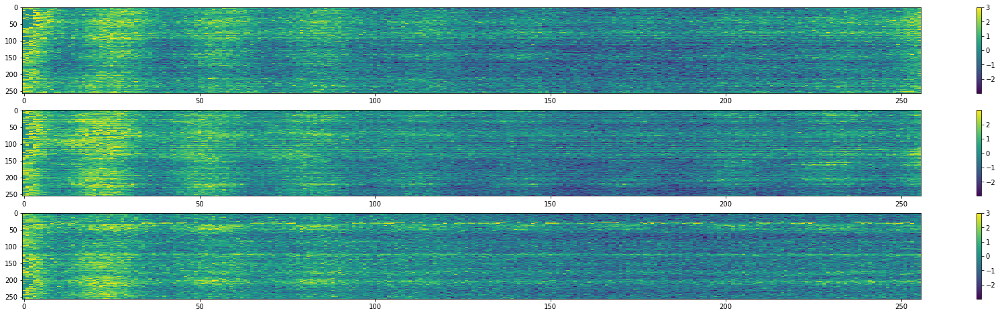

target: 0 | id: 00042890562ff68
mean: 0.005765941260506224
std: 0.9965858755386092
mean: -0.008400097762205405
std: 0.9824541939737761
mean: 0.018837253835044976
std: 1.0115549160011268


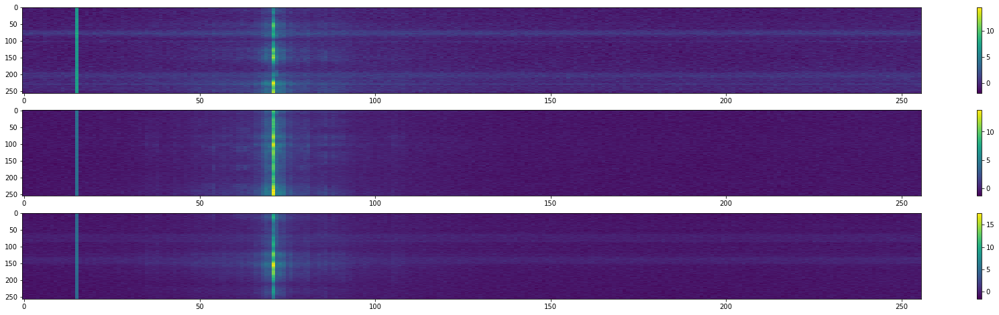

mean: -0.07071308969807433
std: 0.6901569610577514
mean: -0.10285142356860888
std: 0.5879245046939755
mean: -0.07404449854675477
std: 0.6270123828797103


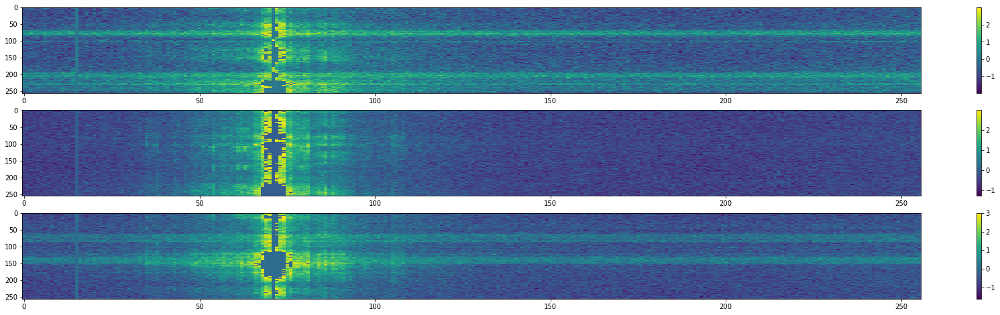

target: 0 | id: 0005364cdcb8e5b
mean: 0.050312111978200846
std: 0.9995073762849606
mean: -0.05792644291432225
std: 0.9411254723333867
mean: 0.03208438381898304
std: 1.0151611056338206


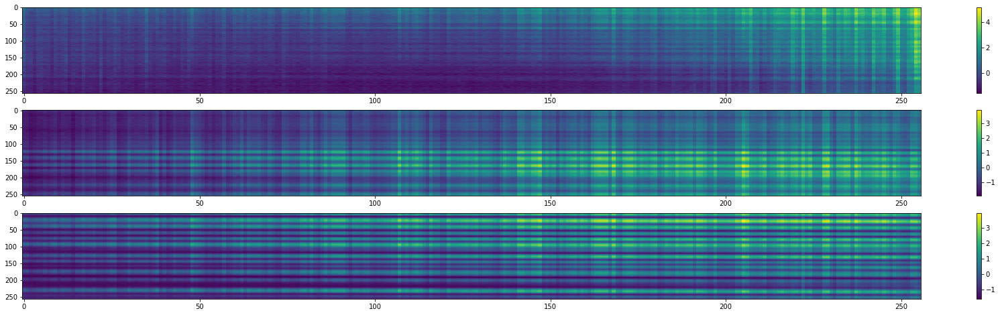

mean: 0.008951205874836887
std: 0.9252521074233565
mean: -0.06237916245027009
std: 0.9331933463335668
mean: 0.021765997698821593
std: 0.9988036961124477


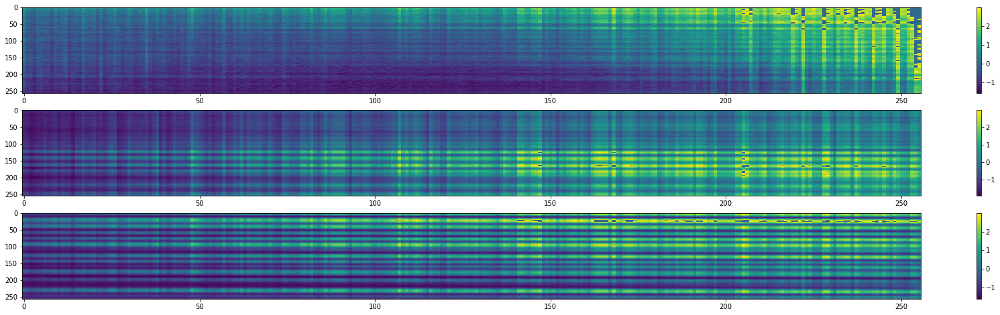

target: 0 | id: 0007a5a46901c56
mean: 0.03443990571759059
std: 0.9930375334489129
mean: -0.007983556419276283
std: 1.0098988775527142
mean: -0.00277864768395375
std: 1.0067149821889831


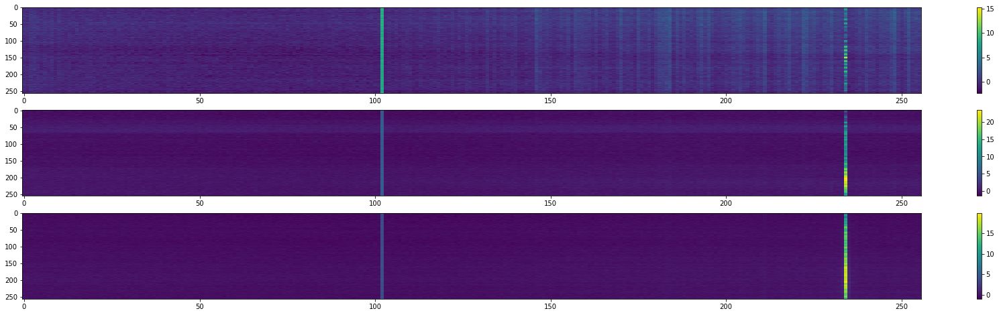

mean: -0.015727012037132226
std: 0.7749484772414881
mean: -0.07838037651890772
std: 0.4023860913595841
mean: -0.07599383940214466
std: 0.2460393552879135


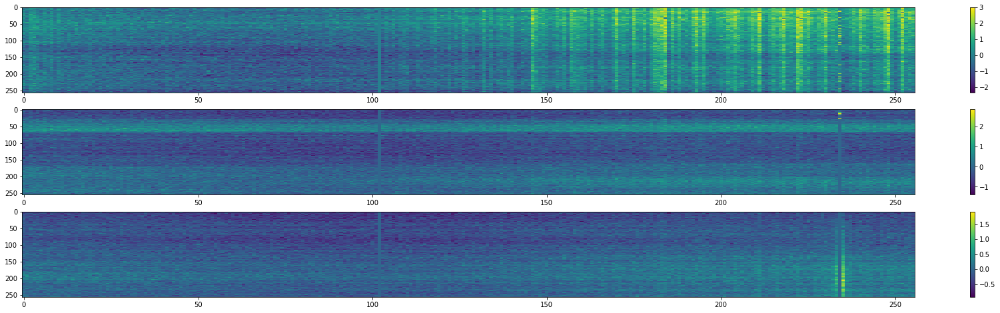

target: 0 | id: 0009283e145448e
mean: 0.01274686223041499
std: 1.0185835005419026
mean: 0.05903282579311053
std: 0.9909004829085626
mean: 0.01571220538517082
std: 1.0172572334143362


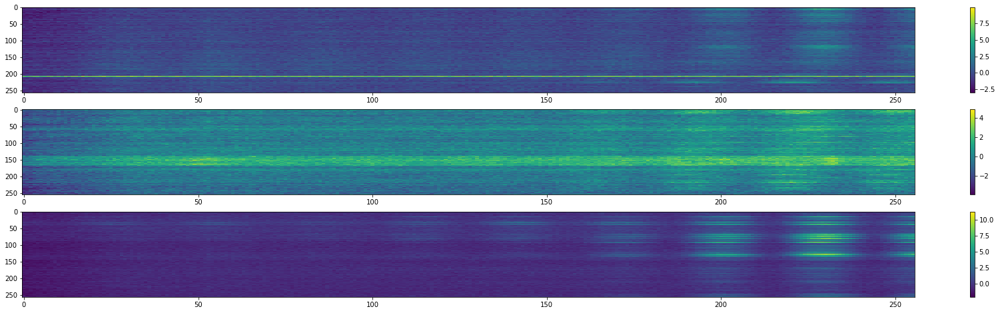

mean: -0.06812901302691898
std: 0.6919717281816781
mean: 0.04187694117354113
std: 0.9548963087049669
mean: -0.09085244936068193
std: 0.6799289720844939


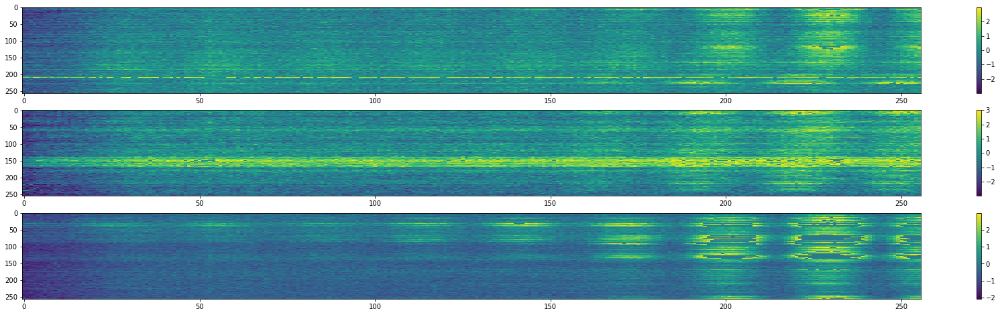

target: 0 | id: 00096524e6670d6
mean: -0.0033410060741516645
std: 1.0068901838423923
mean: 0.054137356932187686
std: 0.9941358970275407
mean: -0.0048301077740688925
std: 0.9994577210881461


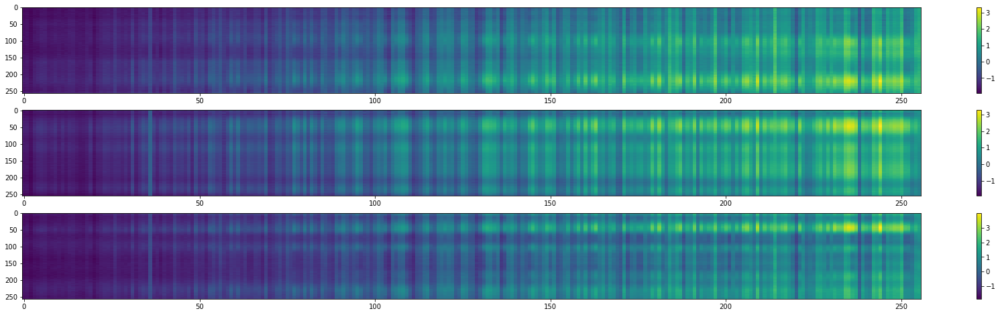

mean: -0.004203814501124725
std: 1.0055391044447939
mean: 0.052663215788015805
std: 0.9919002486215399
mean: -0.012057075347001955
std: 0.9871835409247728


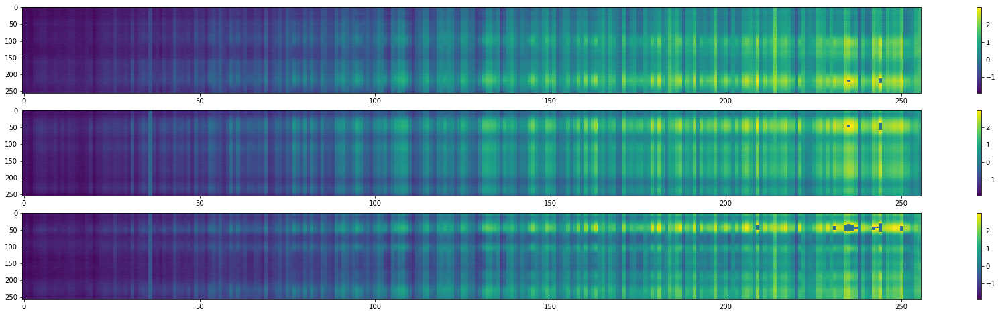

target: 0 | id: 000cd479c2106d4
mean: -0.017249283868295606
std: 1.0126055124376285
mean: -0.09255549973750021
std: 0.9618514287324372
mean: 0.0524538367308196
std: 1.0011903250796241


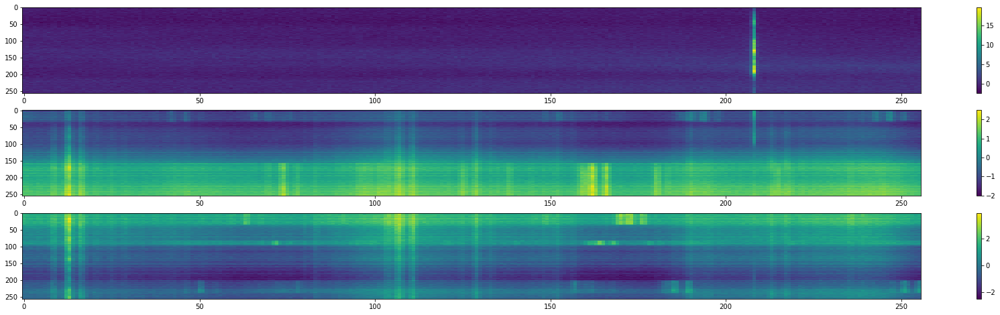

mean: -0.062342507304492756
std: 0.7046868608201784
mean: -0.09255549973750021
std: 0.9618514287324372
mean: 0.049605124567278835
std: 0.9967255747668707


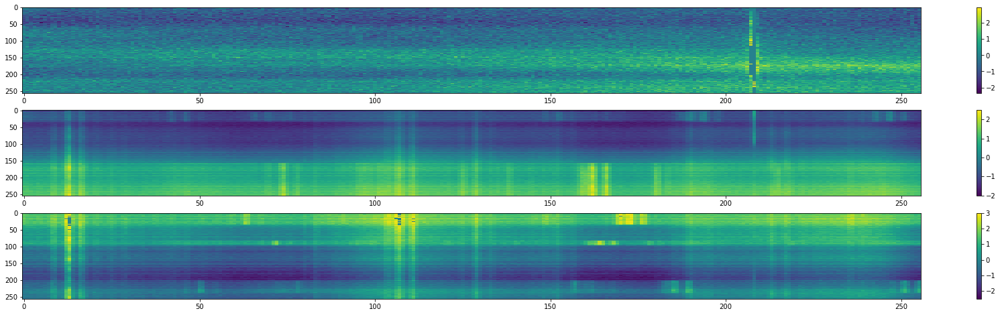

target: 0 | id: 000e869ed875e40
mean: -0.0017892794994622818
std: 0.9999569321419484
mean: -0.002053542797511909
std: 0.9999741698504102
mean: -0.0012337247126197326
std: 1.0000909943859968


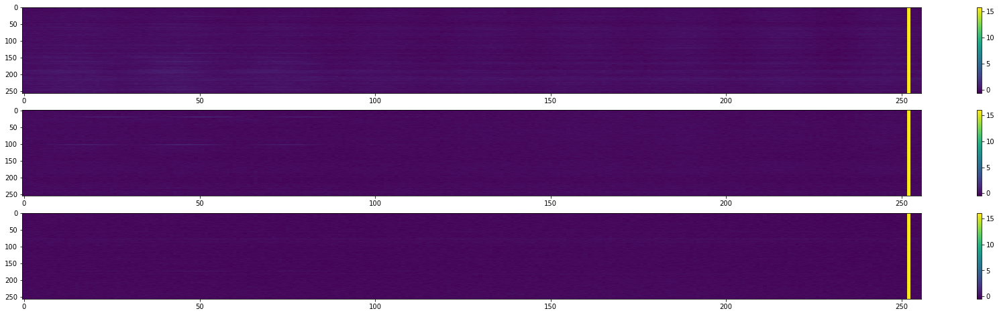

mean: -0.06310481041055027
std: 0.18295591993847246
mean: -0.06400578821921954
std: 0.11533205220012473
mean: -0.06329160679433699
std: 0.10134501576620235


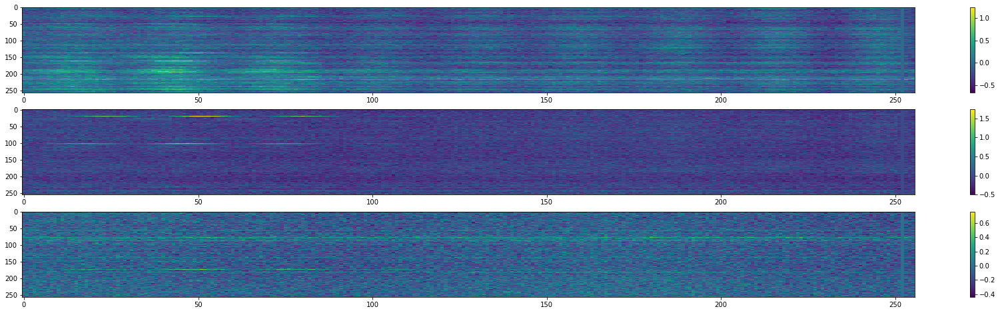

target: 0 | id: 00104dc954c2d30
mean: -7.494080909964396e-05
std: 1.000143151905645
mean: 0.005931479331593437
std: 1.0002118578732717
mean: -0.00013447726450976916
std: 0.9996587747781821


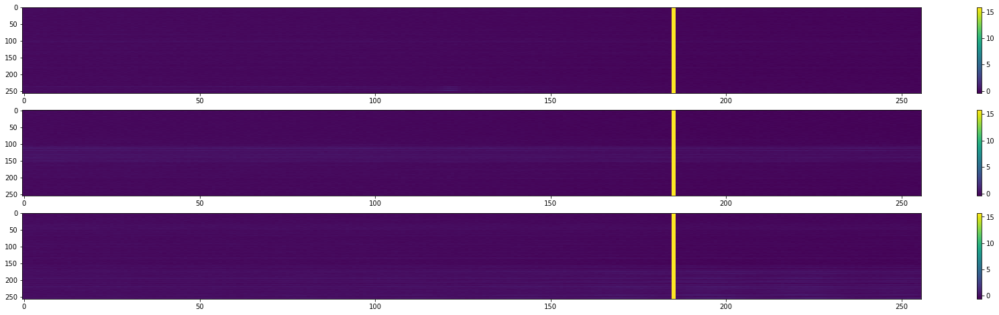

mean: -0.062061508727310866
std: 0.11312273979701337
mean: -0.05538369953956135
std: 0.18693884410878334
mean: -0.0613776788704854
std: 0.1880532109385767


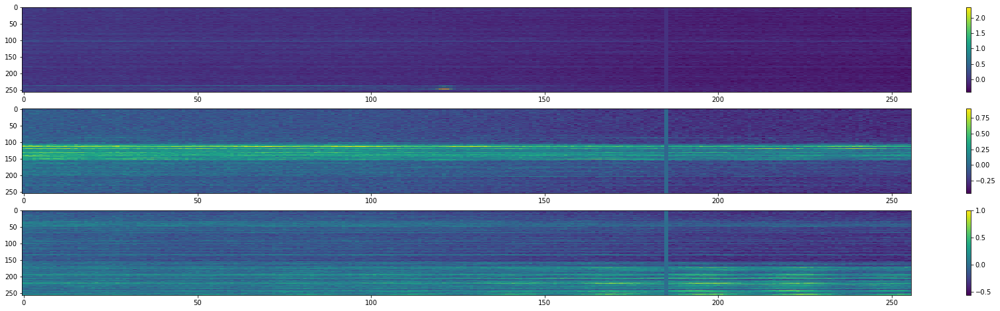

target: 0 | id: 0010ad3ece01536
mean: -0.03237151955545414
std: 0.9908236626723632
mean: -0.04487230436552636
std: 0.9722420280537911
mean: 0.05300969624386198
std: 0.9878832271221831


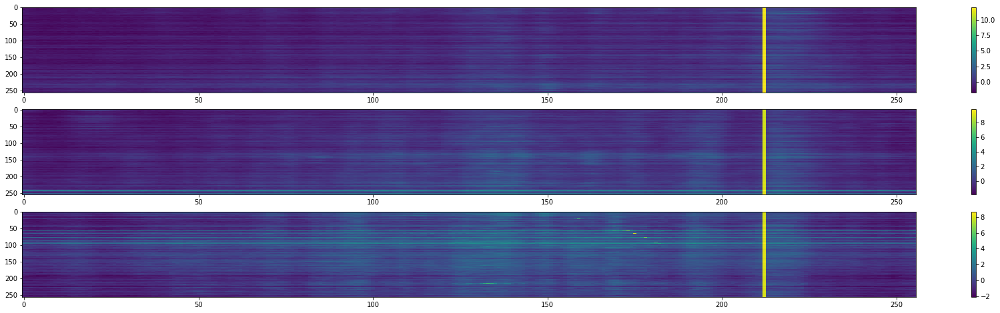

mean: -0.0781231036871759
std: 0.6660303574853301
mean: -0.10051467703669914
std: 0.7424993647116134
mean: 0.010278845010361692
std: 0.8267338617450897


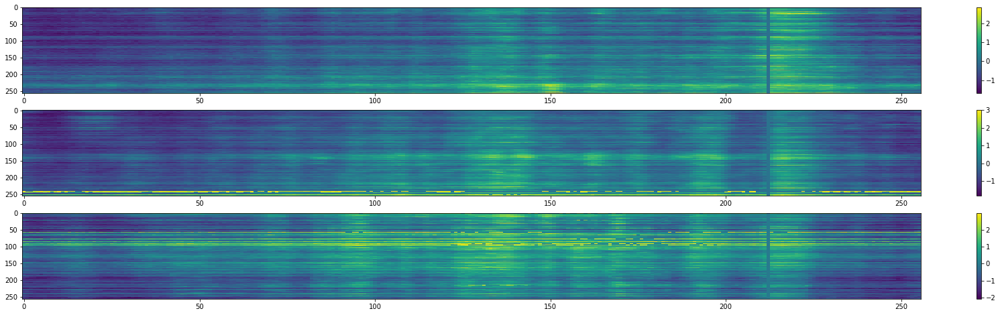

In [25]:
for i in range(0, 10):
    entry = train.loc[train['target'] == 0].iloc[i]
    reading = np.load(entry['img_path'])
    reading = np.take(reading, [0,2,4], 0)

    print('target: ' + str(entry.target) + ' | id: ' + str(entry.id))
    # fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)
    # axs[0].hist(reading[0], bins=200)
    draw(reading)
    for z in range(len(reading)):
        reading[z] = cut_off_extremes(reading[z])
    # for z in range(len(edited_cadence[i])):
    #     edited_cadence[i][z] = cut_off_extremes(edited_cadence[i][z])
    # axs[1].hist(reading[0], bins=200)

    draw(reading)
    #draw(edited_cadence[i])
